<a href="https://colab.research.google.com/github/AyozeGS/IABD/blob/main/SNS/UT3/T3/Ayoze_Gil_Sosa_Act_3_4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Ayoze Gil Sosa

# Importación de librerías

In [260]:
# Libreías para trabajar con ficheros
import zipfile
import shutil
import csv
import os
from io import StringIO
# Librerías para tratamiento y visualización de datos
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
# Librerías para trabajar con modelos de entranamiento
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from sklearn.model_selection import KFold
# Librerías de los modelos a comparar
from sklearn.naive_bayes import BernoulliNB
from sklearn.naive_bayes import CategoricalNB
from sklearn.naive_bayes import ComplementNB
from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import MultinomialNB
from sklearn.svm import SVC

# Carga de datos

In [257]:
zip_path = '/content/all-metrics.zip'
folder_path = '/content/data'
csv_path = '/content/all-metrics.csv'

#Si se ha carga el csv en lugar del zip se produce la excepción y se carga el csv
try:
  data = pd.read_csv(csv_path)
  print("Dataset listo")

except:
  try:
    zipfile.ZipFile(zip_path, 'r').extractall(folder_path)
    shutil.rmtree('/content/data/__MACOSX')

    # Carga todos los CSV en la carpeta en un diccionario de listas de DataFrames
    dataframes = {}
    for root, dirs, files in os.walk('/content/data'):
      if len(files):
        dir = root.split('/')[-1]
        dataframes[dir] = []
        for file in files:
          if file.endswith('.csv'):
            df = pd.read_csv(os.path.join(root, file))
            dataframes[dir].append((file.split('.')[0], df))


    # Crea un dataframe auxiliar que incluye los MB de cada algoritmo y escala
    data_sizes = {
        'L': [359, 7629, 19077, 8, 245, 3830, 15, 45783, 115, 31, 61],
        'H': [1792, 22886, 109875, 15258, 653, 19149, 31, 114463, 668, 183, 191],
        'G': [3594, 38144, 149544, 22886, 1976, 38308, 61, 305203, 1372, 229, 275],
        'B1': [71885, 53402, 171674, 33567, 4260, 229816, 92, 762993, 1720, 257, 374],
        'B2': [71885, 53402, 171674, 33567, 4260, 229816, 92, 762993, 1720, 257, 374]
    }

    indexes = ['nb', 'logr', 'svm', 'rf', 'lda', 'kpar', 'gbt', 'linr', 'als', 'pca', 'svd']
    df_sizes = pd.DataFrame(data_sizes, index=indexes)


    # Concatena y une todos los dataframes vertical y horizontalmente
    data = []

    for dir in dataframes.keys():
      last_component = ''
      model_df = []
      component_df = []

      dataframes[dir] = sorted(dataframes[dir], key=lambda x: x[0])
      for filename, df in dataframes[dir]:
        model, component, scale = filename.split('_')
        df['scale']=scale
        df['data_size_mb']=df_sizes.at[model, scale]
        if component == last_component:
          component_df = pd.concat([component_df, df], axis=0)
        else:
          if len(component_df):
            if not len(model_df):
              model_df = component_df
            else:
              model_df = pd.merge(model_df, component_df, on=['moment', 'node', 'scale', 'data_size_mb'], how='inner')
          component_df = df
          last_component = component
      model_df = pd.merge(model_df, component_df, on=['moment', 'node', 'scale', 'data_size_mb'], how='inner')
      model_df['model']=model
      data.append(model_df)

    data = pd.concat(data, ignore_index=True)

    data.to_csv("all-metrics.csv", index=False)
    print("Dataset listo")
  except:
    print("No se han subido archivos con el dataset")

Dataset listo


# Limpieza y procesamiento

* Se comprueba si los datos están balanceados para el target
* Se eliminan/procesan aquellas filas que contengan valores NaN
* Se eliminan/procesan aquellas filas que contengan valores inadecuados
* Se transforman (a valores categóricos) o eliminan las columnas no numéricas
* Se filtran los valores que se crean oportunos
* Se eliminan las columnas que se consideran
* Se escalan los datos

In [326]:
df = data.copy()

# Campo target
field_name = "model"
#Guardamos un array con las valores no numéricos de los modelos
field_categories = df[field_name].unique()

df

,moment,node,user,system,iowait,softirq,idle,scale,data_size_mb,bytes_read,...,map,used,recv_packets,send_bytes,send_packets,load5,load10,load15,procs,model
0,1,3,0.149869,0.049956,0.012489,0.000000,99.787686,B1,4260,0,...,59948,2209032,59,29256,61,6.07,6.89,6.09,497,lda
1,1,5,0.099963,0.037486,0.012495,0.000000,99.850056,B1,4260,0,...,60000,2108312,57,25027,58,6.11,6.99,6.29,498,lda
2,1,2,0.162419,0.037481,0.037481,0.000000,99.762619,B1,4260,0,...,60120,2158732,79,33799,81,10.37,11.45,10.26,501,lda
3,1,4,0.049975,0.024988,0.024988,0.000000,99.900050,B1,4260,0,...,60116,2140444,38,10945,45,5.13,6.69,6.20,503,lda
4,1,7,0.124860,0.049944,0.000000,0.000000,99.825197,B1,4260,0,...,59904,2268860,60,13464,58,6.05,6.78,5.95,495,lda
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40000,7,3,27.141964,0.637899,0.012508,0.050031,72.157598,L,3830,0,...,79508,6701788,2102,724633,2312,1.54,1.05,1.68,699,kpar
40001,7,7,26.277555,0.764028,0.025050,0.037575,72.895792,L,3830,0,...,79576,6861748,2214,3610440,2311,2.11,1.14,1.30,696,kpar
40002,7,5,18.868161,0.538375,0.000000,0.025041,80.568424,L,3830,0,...,79512,6908520,2011,818822,2180,2.56,1.60,1.60,696,kpar
40003,7,6,21.917637,0.613343,0.012517,0.012517,77.443985,L,3830,0,...,79416,6655244,2132,840133,2322,1.21,0.98,1.35,686,kpar


Comprobamos registros de cada categoría en la columna que usaremos como target

In [327]:
#Comprobamos la cantidad de registros de cada modelo
df['model'].value_counts()

kpar    8491
gbt     8260
lda     4620
linr    3941
logr    3780
rf      3094
pca     2982
nb      1428
svm     1421
als     1120
svd      868
Name: model, dtype: int64

Se comprueban valores nulos

In [328]:
#Comprobamos que no hay valores nulos
df.isna().sum()

moment              0
node                0
user                0
system              0
iowait              0
softirq             0
idle                0
scale               0
data_size_mb        0
bytes_read          0
bytes_write         0
io_read             0
io_write            0
time_spent_read     0
time_spent_write    0
buffer_cache        0
free                0
map                 0
used                0
recv_packets        0
send_bytes          0
send_packets        0
load5               0
load10              0
load15              0
procs               0
model               0
dtype: int64

Sabemos como B1 y B2 son realmente la misma escala, así que las unimos en una única escala B.

In [329]:
# Visualización de un registro de cada categoría antes
display(df.drop_duplicates('scale', keep='first'))
print(f"{df.shape[0]} rows x {df.shape[1]} columns")

df.loc[(df['scale'] == 'B1') | (df['scale'] == 'B2'), 'scale'] = 'B'

# Visualización de un registro de cada categoría después
display(df.drop_duplicates('scale', keep='first'))
print(f"{df.shape[0]} rows x {df.shape[1]} columns")

,moment,node,user,system,iowait,softirq,idle,scale,data_size_mb,bytes_read,...,map,used,recv_packets,send_bytes,send_packets,load5,load10,load15,procs,model
0,1,3,0.149869,0.049956,0.012489,0.0,99.787686,B1,4260,0,...,59948,2209032,59,29256,61,6.07,6.89,6.09,497,lda
1792,1,2,0.112402,0.049956,0.049956,0.0,99.787686,B2,4260,0,...,60060,2704992,59,30032,61,6.32,7.23,6.37,516,lda
3591,1,2,0.112444,0.037481,0.024988,0.0,99.825087,G,1976,0,...,59964,2344696,47,25216,46,6.02,5.28,4.27,513,lda
4228,1,3,0.174847,0.024978,0.062445,0.0,99.737729,H,653,0,...,60412,2528032,59,49005,61,7.34,5.31,7.02,517,lda
4494,1,2,0.199825,0.062445,0.000000,0.0,99.737729,L,245,0,...,59928,2262444,87,31167,86,1.56,1.46,1.82,512,lda


40005 rows x 27 columns


,moment,node,user,system,iowait,softirq,idle,scale,data_size_mb,bytes_read,...,map,used,recv_packets,send_bytes,send_packets,load5,load10,load15,procs,model
0,1,3,0.149869,0.049956,0.012489,0.0,99.787686,B,4260,0,...,59948,2209032,59,29256,61,6.07,6.89,6.09,497,lda
3591,1,2,0.112444,0.037481,0.024988,0.0,99.825087,G,1976,0,...,59964,2344696,47,25216,46,6.02,5.28,4.27,513,lda
4228,1,3,0.174847,0.024978,0.062445,0.0,99.737729,H,653,0,...,60412,2528032,59,49005,61,7.34,5.31,7.02,517,lda
4494,1,2,0.199825,0.062445,0.000000,0.0,99.737729,L,245,0,...,59928,2262444,87,31167,86,1.56,1.46,1.82,512,lda


40005 rows x 27 columns


Se tranforman las columnas no numéricas a valores categóricos excepto el target. En este caso la única columna en pasarse es scale

In [330]:
# Transformar las columnas con datos no númericos a valores categóricos
all_columns_to_categorical = True
field_name_to_categorical = False

# Visualización de un registro de cada categoría antes y después
display(df.drop_duplicates('scale', keep='first'))
print(f"{df.shape[0]} rows x {df.shape[1]} columns")

# Se transforman las variables no numéricas a categóricas
if all_columns_to_categorical:
  for column in df.columns:
    # Revisa el campo a predecir de forma individual
    if column == field_name and not field_name_to_categorical:
      continue
    # Comprueba las columna no numéricas para pasarlo a valores categóricos
    if not (pd.api.types.is_numeric_dtype(df[column].dtype)):
      types = df[column].unique()
      df[column].replace(types, range(len(types)), inplace=True);
# Se eliminan las variables no numéricas
else:
  for column in df.columns:
    # Revisa el campo a predecir de forma individual
    if column == field_name:
      continue
    # Elimina las columnas
    if not (pd.api.types.is_numeric_dtype(df[column].dtype)):
      del df[column]

# Visualización de un registro de cada categoría antes y después
display(df.drop_duplicates('scale', keep='first'))
print(f"{df.shape[0]} rows x {df.shape[1]} columns")

,moment,node,user,system,iowait,softirq,idle,scale,data_size_mb,bytes_read,...,map,used,recv_packets,send_bytes,send_packets,load5,load10,load15,procs,model
0,1,3,0.149869,0.049956,0.012489,0.0,99.787686,B,4260,0,...,59948,2209032,59,29256,61,6.07,6.89,6.09,497,lda
3591,1,2,0.112444,0.037481,0.024988,0.0,99.825087,G,1976,0,...,59964,2344696,47,25216,46,6.02,5.28,4.27,513,lda
4228,1,3,0.174847,0.024978,0.062445,0.0,99.737729,H,653,0,...,60412,2528032,59,49005,61,7.34,5.31,7.02,517,lda
4494,1,2,0.199825,0.062445,0.000000,0.0,99.737729,L,245,0,...,59928,2262444,87,31167,86,1.56,1.46,1.82,512,lda


40005 rows x 27 columns


,moment,node,user,system,iowait,softirq,idle,scale,data_size_mb,bytes_read,...,map,used,recv_packets,send_bytes,send_packets,load5,load10,load15,procs,model
0,1,3,0.149869,0.049956,0.012489,0.0,99.787686,0,4260,0,...,59948,2209032,59,29256,61,6.07,6.89,6.09,497,lda
3591,1,2,0.112444,0.037481,0.024988,0.0,99.825087,1,1976,0,...,59964,2344696,47,25216,46,6.02,5.28,4.27,513,lda
4228,1,3,0.174847,0.024978,0.062445,0.0,99.737729,2,653,0,...,60412,2528032,59,49005,61,7.34,5.31,7.02,517,lda
4494,1,2,0.199825,0.062445,0.000000,0.0,99.737729,3,245,0,...,59928,2262444,87,31167,86,1.56,1.46,1.82,512,lda


40005 rows x 27 columns


Se comprueban valores negativos

In [331]:
#Comprobamos filas con valores negativos
df[df[df.drop(['model'],axis=1)<0].any(axis=1)]

,moment,node,user,system,iowait,softirq,idle,scale,data_size_mb,bytes_read,...,map,used,recv_packets,send_bytes,send_packets,load5,load10,load15,procs,model
36473,123,4,5.047476,0.074963,-0.012494,0.049975,94.84008,0,229816,0,...,79676,39238388,5056,298072,4261,8.59,8.51,7.35,680,kpar


En el caso concreto las columnas entre 'user' y 'idle' suman 100. Por ello en lugar d eliminar la fila pondremos a 0 el valor negativo y reduciremos esa cantidad de idle.

In [332]:
df.loc[df[df.drop(['model'],axis=1)<0].any(axis=1), 'idle'] -= df.loc[df[df.drop(['model'],axis=1)<0].any(axis=1), 'iowait']
df.loc[df[df.drop(['model'],axis=1)<0].any(axis=1), 'iowait'] = 0
df.iloc[36473, 2:7]

user        5.047476
system      0.074963
iowait           0.0
softirq     0.049975
idle       94.852574
Name: 36473, dtype: object

Observamos los instantes finales alcanzdos para cada combinación de modelo y escala, porque son causantes del desbalanceo en la cantidad de muestras de cada modelo

In [333]:
# Visualización de un registro de cada categoría después
display(df.drop_duplicates(['scale','model'], keep='last'))
print(f"{df.shape[0]} rows x {df.shape[1]} columns")

,moment,node,user,system,iowait,softirq,idle,scale,data_size_mb,bytes_read,...,map,used,recv_packets,send_bytes,send_packets,load5,load10,load15,procs,model
3590,257,7,0.723914,0.099850,0.012481,0.000000,99.163754,0,4260,0,...,80552,17080528,228,811307,245,23.40,28.71,24.11,697,lda
4227,91,2,0.911588,0.087413,0.012488,0.000000,98.988511,1,1976,0,...,80436,16394436,131,705557,150,27.06,24.41,14.19,698,lda
4493,38,6,1.898339,0.099913,0.024978,0.012489,97.964281,2,653,0,...,83204,22557608,217,484685,244,40.03,22.42,11.76,842,lda
4619,18,1,0.624532,0.124906,0.012491,0.000000,99.238071,3,245,0,...,80412,14397388,366,190191,394,7.61,4.64,3.55,694,lda
9645,373,6,5.644356,1.523477,0.012488,0.024975,92.794705,0,92,0,...,81680,27316820,6211,7909984,2809,0.18,0.61,3.94,844,gbt
11423,254,7,5.437500,0.150000,0.000000,0.012500,94.400000,1,61,0,...,79440,16929628,2334,4528600,1873,0.29,1.16,2.07,803,gbt
12361,134,7,4.934416,0.099938,0.012492,0.024984,94.928170,2,31,0,...,77184,6954844,1940,5292601,1547,0.90,1.10,3.88,665,gbt
12879,74,1,4.899388,2.074741,0.012498,0.024997,92.988376,3,15,0,...,79948,5012572,5356,9756890,3310,1.70,3.27,3.05,697,gbt
15357,174,1,0.062461,0.024984,0.000000,0.000000,99.912555,0,53402,0,...,79764,27622076,24,5837,29,5.99,5.92,6.49,690,logr
16176,117,1,9.664916,0.375094,0.000000,0.150038,89.797449,1,38144,0,...,79496,27826976,54157,3236032,48822,5.81,3.96,2.92,683,logr


40005 rows x 27 columns


In [334]:
# Visualización de un registro de cada categoría después
print("Mínimo instante de tiempo final:", df.drop_duplicates(['scale','model'], keep='last')['moment'].min())
print("Máximo instante de tiempo final", df.drop_duplicates(['scale','model'], keep='last')['moment'].max())

Mínimo instante de tiempo final: 5
Máximo instante de tiempo final 593


Filtramos los resgitros con un moment menor a 50 para obtener un mejor balance de los target

In [335]:
df = df[df['moment']<=50]
# Visualización de registros de cada categoría
rows_before = data[field_name].value_counts()
rows_after = df[field_name].value_counts()
display(pd.DataFrame(pd.concat([rows_before, rows_after], axis=1, keys=["before", "after"])))
print(f"\n{data.shape[0] - df.shape[0]} rows deleted\n")

,before,after
kpar,8491,945
gbt,8260,1750
lda,4620,1442
linr,3941,1288
logr,3780,1512
rf,3094,1435
pca,2982,1526
nb,1428,854
svm,1421,1246
als,1120,1120



26019 rows deleted



Estimación de la distribución de las diferentes variables por nodo

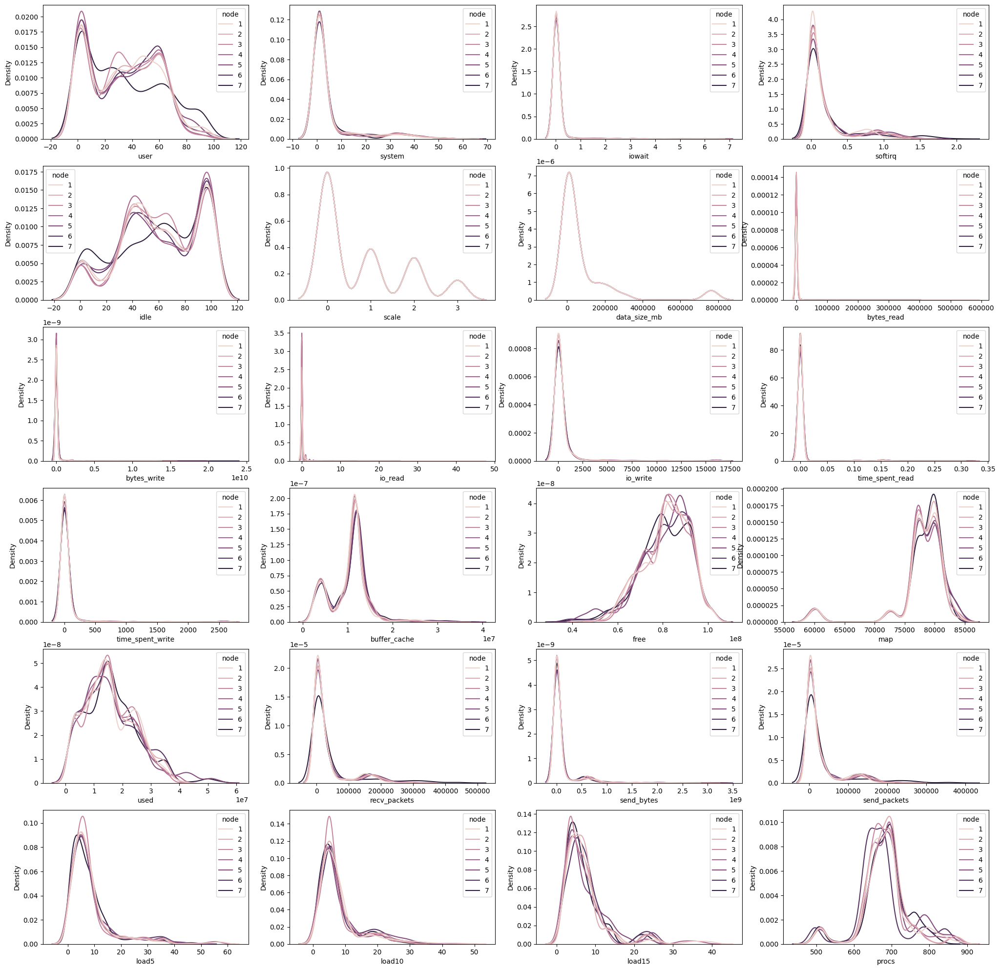

In [336]:
cols = df.drop(['model', 'moment'], axis=1).columns

fig, ax = plt.subplots(nrows=int(np.floor(len(cols)/4)), ncols = 4, figsize = (25, 25))

i,j = 0,0
for c in cols:
  if c != 'node':
    sns.kdeplot(df, x=c, hue='node', common_norm=False, fill=False, ax=ax[i, j], legend=True)

    j+=1
    if j==4:
        i+=1
        j=0

plt.show();

Se ha decidido eliminar las columnas moment, node y scale.
Aplicamos SelectKBest para contrastar

In [337]:
# Crear el objeto SelectKBest
k_best = SelectKBest(score_func=chi2, k='all')
# Aplicar la transformación a tus datos
k_best.fit_transform(df.drop('model', axis=1), df['model'])
# Obtener las puntuaciones de las características y los índices de las características seleccionadas
feature_scores = pd.DataFrame({'Feature': df.drop('model', axis=1).columns, 'Score': k_best.scores_})
# Ordenar las características por puntuación en orden descendente
feature_scores = feature_scores.sort_values(by='Score', ascending=False)
# Obtener los índices de las características seleccionadas después de la ordenación
selected_features_indices = k_best.get_support(indices=True)
# Imprimir las puntuaciones y las características seleccionadas
print("Puntuaciones de características:")
print(feature_scores)

Puntuaciones de características:
             Feature         Score
20        send_bytes  2.808643e+12
10       bytes_write  1.699072e+12
18              used  2.039295e+10
16              free  4.870546e+09
15      buffer_cache  3.842560e+09
8       data_size_mb  3.680079e+09
19      recv_packets  9.452068e+08
21      send_packets  7.308249e+08
9         bytes_read  3.202788e+07
12          io_write  1.097866e+07
14  time_spent_write  2.087899e+06
17               map  2.664678e+05
3             system  1.916210e+05
2               user  8.997139e+04
6               idle  8.243213e+04
22             load5  6.004951e+04
23            load10  4.297432e+04
24            load15  3.059757e+04
25             procs  5.357680e+03
0             moment  4.517417e+03
5            softirq  4.501700e+03
4             iowait  4.364117e+03
11           io_read  2.718281e+03
7              scale  8.207168e+02
13   time_spent_read  1.591393e+02
1               node  1.330990e-24


Eliminamos las columnas

In [338]:
df = df.drop(['moment', 'node', 'scale'], axis=1)

Escalamos el resto de columnas numéricas

In [366]:
scaler = MinMaxScaler()
columns = df.drop(['model'], axis=1).columns
for column in columns:
  df[column] = scaler.fit_transform(df[[column]])
df.head()

,user,system,iowait,softirq,idle,data_size_mb,bytes_read,bytes_write,io_read,io_write,...,map,used,recv_packets,send_bytes,send_packets,load5,load10,load15,procs,model
0,0.001377,0.000798,0.001853,0.0,0.998002,0.005573,0.0,0.005989,0.0,0.001333,...,0.020379,0.006270,0.000104,0.000008,0.000114,0.103725,0.136082,0.129648,0.034146,lda
1,0.000877,0.000599,0.001854,0.0,0.998625,0.005573,0.0,0.005988,0.0,0.001333,...,0.022465,0.004358,0.000100,0.000006,0.000107,0.104409,0.138144,0.134606,0.036585,lda
2,0.001502,0.000599,0.005560,0.0,0.997751,0.005573,0.0,0.008987,0.0,0.001817,...,0.027279,0.005316,0.000147,0.000009,0.000165,0.177204,0.230103,0.233019,0.043902,lda
3,0.000376,0.000399,0.003707,0.0,0.999125,0.005573,0.0,0.005990,0.0,0.001515,...,0.027118,0.004968,0.000059,0.000002,0.000074,0.087662,0.131959,0.132375,0.048780,lda
4,0.001126,0.000798,0.000000,0.0,0.998377,0.005573,0.0,0.000002,0.0,0.000121,...,0.018614,0.007406,0.000106,0.000003,0.000107,0.103383,0.133814,0.126177,0.029268,lda


# Selección de características

1. Se comprueban las diferentes columnas disponibles

2. Se transforman (a valores categóricos) la columna target
3. SelectKBest
4. Skewness/Kurtosis
5. Matriz de correlación
6. Matriz de dispersión
7. Selección de columnas

Se observan las columnas restantes

In [339]:
df.columns

Index(['user', 'system', 'iowait', 'softirq', 'idle', 'data_size_mb',
       'bytes_read', 'bytes_write', 'io_read', 'io_write', 'time_spent_read',
       'time_spent_write', 'buffer_cache', 'free', 'map', 'used',
       'recv_packets', 'send_bytes', 'send_packets', 'load5', 'load10',
       'load15', 'procs', 'model'],
      dtype='object')

Pasamos la columna de target a valores numéricos

In [373]:
#Cambiamos la columna de target a valores numéricos
types = df['model'].unique()
df['model'].replace(types, range(len(types)), inplace=True);

# Visualización de un registro de cada categoría después
display(df.drop_duplicates('model', keep='first'))
print(f"{df.shape[0]} rows x {df.shape[1]} columns")

,user,system,iowait,softirq,idle,data_size_mb,bytes_read,bytes_write,io_read,io_write,...,map,used,recv_packets,send_bytes,send_packets,load5,load10,load15,procs,model
0,0.001377,0.000798,0.001853,0.000000,0.998002,0.005573,0.0,5.988619e-03,0.0,0.001333,...,0.020379,0.006270,0.000104,7.772198e-06,0.000114,0.103725,0.136082,0.129648,0.034146,0
4620,0.001502,0.000200,0.009265,0.000000,0.997751,0.000110,0.0,1.919094e-06,0.0,0.000121,...,0.014763,0.002742,0.000117,4.053842e-06,0.000120,0.378674,0.338144,0.212196,0.048780,1
12880,0.001002,0.000399,0.003707,0.006062,0.998376,0.069980,0.0,7.967729e-03,0.0,0.002181,...,0.020218,0.003446,0.000104,8.062019e-06,0.000107,0.131921,0.163918,0.182449,0.019512,2
16660,0.001502,0.000399,0.074127,0.000000,0.993253,0.002244,0.0,4.891236e-01,0.0,0.013085,...,0.013479,0.002166,0.000125,4.846283e-06,0.000130,0.104067,0.117113,0.139812,0.046341,3
17780,0.001251,0.000599,0.003704,0.000000,0.998127,0.224993,0.0,5.984432e-03,0.0,0.001999,...,0.020379,0.006441,0.000104,7.271404e-06,0.000112,0.376452,0.621856,0.620724,0.029268,4
19201,0.000375,0.000200,0.000000,0.000000,0.999500,0.000326,0.0,0.000000e+00,0.0,0.000000,...,0.042362,0.004224,0.000013,4.207277e-07,0.000020,0.014525,0.011959,0.022806,0.021951,5
22183,0.000501,0.000200,0.000000,0.000000,0.999375,0.094205,0.0,1.744631e-07,0.0,0.000061,...,0.028402,0.001983,0.000028,6.371802e-07,0.000033,0.000342,0.037526,0.073624,0.002439,6
23611,0.001377,0.000200,0.001853,0.000000,0.998376,0.043984,0.0,4.582622e-03,0.0,0.000909,...,0.026155,0.003273,0.000113,1.003658e-05,0.000130,0.083732,0.107423,0.120724,0.036585,7
26705,0.000501,0.000399,0.000000,0.000000,0.999251,1.000000,0.0,6.978523e-07,0.0,0.000121,...,0.006739,0.005217,0.000055,2.098159e-06,0.000066,0.014012,0.071753,0.065444,0.034146,8
30646,0.001252,0.000798,0.012969,0.000000,0.997377,0.000480,0.0,3.203421e-02,0.0,0.002908,...,0.012837,0.004330,0.000108,9.149152e-06,0.000122,0.141832,0.182887,0.176996,0.041463,9


13986 rows x 24 columns


SelectKbest

In [367]:
# Crear el objeto SelectKBest
k_best = SelectKBest(score_func=chi2, k='all')
# Aplicar la transformación a tus datos
k_best.fit_transform(df.drop('model', axis=1), df['model'])
# Obtener las puntuaciones de las características y los índices de las características seleccionadas
feature_scores = pd.DataFrame({'Feature': df.drop('model', axis=1).columns, 'Score': k_best.scores_})
# Ordenar las características por puntuación en orden descendente
feature_scores = feature_scores.sort_values(by='Score', ascending=False)
# Obtener los índices de las características seleccionadas después de la ordenación
selected_features_indices = k_best.get_support(indices=True)
# Imprimir las puntuaciones y las características seleccionadas
print("Puntuaciones de características:")
print(feature_scores)

Puntuaciones de características:
             Feature        Score
5       data_size_mb  4823.727717
1             system  3061.729172
3            softirq  2184.147979
16      recv_packets  2008.955038
18      send_packets  1859.566201
19             load5  1026.136586
20            load10   920.005141
0               user   901.962296
21            load15   862.076570
17        send_bytes   855.076291
4               idle   824.424313
11  time_spent_write   787.923344
9           io_write   665.091229
2             iowait   647.398150
10   time_spent_read   497.310280
15              used   439.488876
12      buffer_cache   138.418306
13              free   126.901028
7        bytes_write    72.369451
8            io_read    57.835766
6         bytes_read    55.065543
14               map    45.336885
22             procs    45.190161


Miramos Skewness y Kurtosis

In [358]:
print("Columna -> Skewness | Kurtosis")
for column in df.drop(["model"],axis=1).columns:
    print(f"{column} ->  {df[column].skew()} |  {df[column].kurt()} ")

Columna -> Skewness | Kurtosis
user ->  0.2180015036234014 |  -1.0434840639127725 
system ->  2.52977549144846 |  5.5865764625796865 
iowait ->  7.180129082301305 |  56.80799822204354 
softirq ->  2.2760115188682652 |  4.7205598199017995 
idle ->  -0.3311043067792721 |  -0.9306539897442594 
data_size_mb ->  3.062653464368531 |  9.03919836910637 
bytes_read ->  23.947801735615403 |  673.8356784611918 
bytes_write ->  18.205802417148234 |  437.9422723555307 
io_read ->  31.13812856073136 |  1672.8306935867795 
io_write ->  6.498922264746078 |  46.432699864111605 
time_spent_read ->  7.758188084502381 |  66.21200164793659 
time_spent_write ->  6.947590459613786 |  52.19451316003151 
buffer_cache ->  0.5138218130697938 |  2.8263434802958702 
free ->  -0.647387955468623 |  0.43340165098021366 
map ->  -2.759947955301918 |  8.03618566165834 
used ->  0.6285277142452063 |  0.27905000860379925 
recv_packets ->  2.5270969862132158 |  6.622169086221411 
send_bytes ->  4.904994504381737 |  31.251

Matriz de correlación

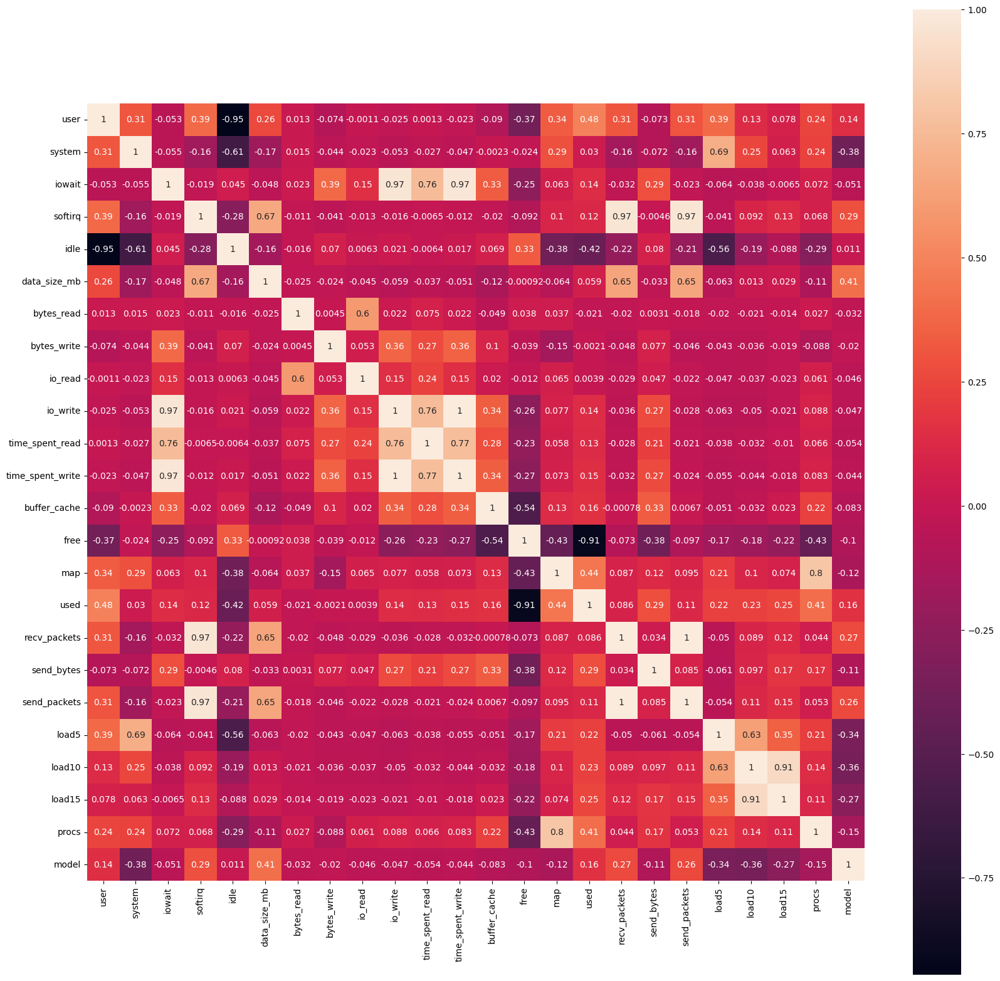

In [374]:
fig, ax = plt.subplots(figsize=(20,20))
sns.heatmap(df.corr(), square=True, annot=True, ax=ax);

In [376]:
df.corr()

,user,system,iowait,softirq,idle,data_size_mb,bytes_read,bytes_write,io_read,io_write,...,map,used,recv_packets,send_bytes,send_packets,load5,load10,load15,procs,model
user,1.000000,0.314738,-0.053232,0.388130,-0.945251,0.259284,0.012722,-0.073625,-0.001098,-0.024849,...,0.337781,0.483953,0.314444,-0.072601,0.308361,0.389295,0.128259,0.078220,0.242673,0.142900
system,0.314738,1.000000,-0.055333,-0.162593,-0.606625,-0.174716,0.015041,-0.044478,-0.023457,-0.052534,...,0.291490,0.029515,-0.155931,-0.072197,-0.164957,0.689732,0.253044,0.063012,0.237236,-0.379882
iowait,-0.053232,-0.055333,1.000000,-0.018925,0.044567,-0.047901,0.023156,0.390395,0.149666,0.965934,...,0.063200,0.138227,-0.031940,0.285459,-0.022608,-0.063718,-0.038212,-0.006489,0.071582,-0.051120
softirq,0.388130,-0.162593,-0.018925,1.000000,-0.276688,0.666966,-0.011037,-0.041249,-0.013273,-0.015712,...,0.101461,0.118075,0.968342,-0.004633,0.965584,-0.041125,0.092060,0.129474,0.067723,0.291349
idle,-0.945251,-0.606625,0.044567,-0.276688,1.000000,-0.161203,-0.016152,0.069706,0.006321,0.020570,...,-0.384826,-0.417264,-0.217047,0.080117,-0.208997,-0.562104,-0.194892,-0.088226,-0.286579,0.010848
data_size_mb,0.259284,-0.174716,-0.047901,0.666966,-0.161203,1.000000,-0.025498,-0.023949,-0.045056,-0.059223,...,-0.064104,0.059263,0.646972,-0.032753,0.654299,-0.063235,0.012800,0.029295,-0.113043,0.411049
bytes_read,0.012722,0.015041,0.023156,-0.011037,-0.016152,-0.025498,1.000000,0.004488,0.595807,0.021827,...,0.036915,-0.021204,-0.019658,0.003143,-0.018161,-0.020500,-0.021170,-0.014161,0.027007,-0.032118
bytes_write,-0.073625,-0.044478,0.390395,-0.041249,0.069706,-0.023949,0.004488,1.000000,0.052874,0.364128,...,-0.149968,-0.002053,-0.047734,0.076975,-0.045743,-0.043013,-0.035702,-0.018992,-0.087792,-0.020198
io_read,-0.001098,-0.023457,0.149666,-0.013273,0.006321,-0.045056,0.595807,0.052874,1.000000,0.151750,...,0.065198,0.003874,-0.028948,0.047175,-0.022341,-0.046747,-0.036905,-0.022688,0.061173,-0.046143
io_write,-0.024849,-0.052534,0.965934,-0.015712,0.020570,-0.059223,0.021827,0.364128,0.151750,1.000000,...,0.077354,0.139627,-0.035982,0.266125,-0.028058,-0.062899,-0.050286,-0.020507,0.087522,-0.046713


Matriz de dispersión

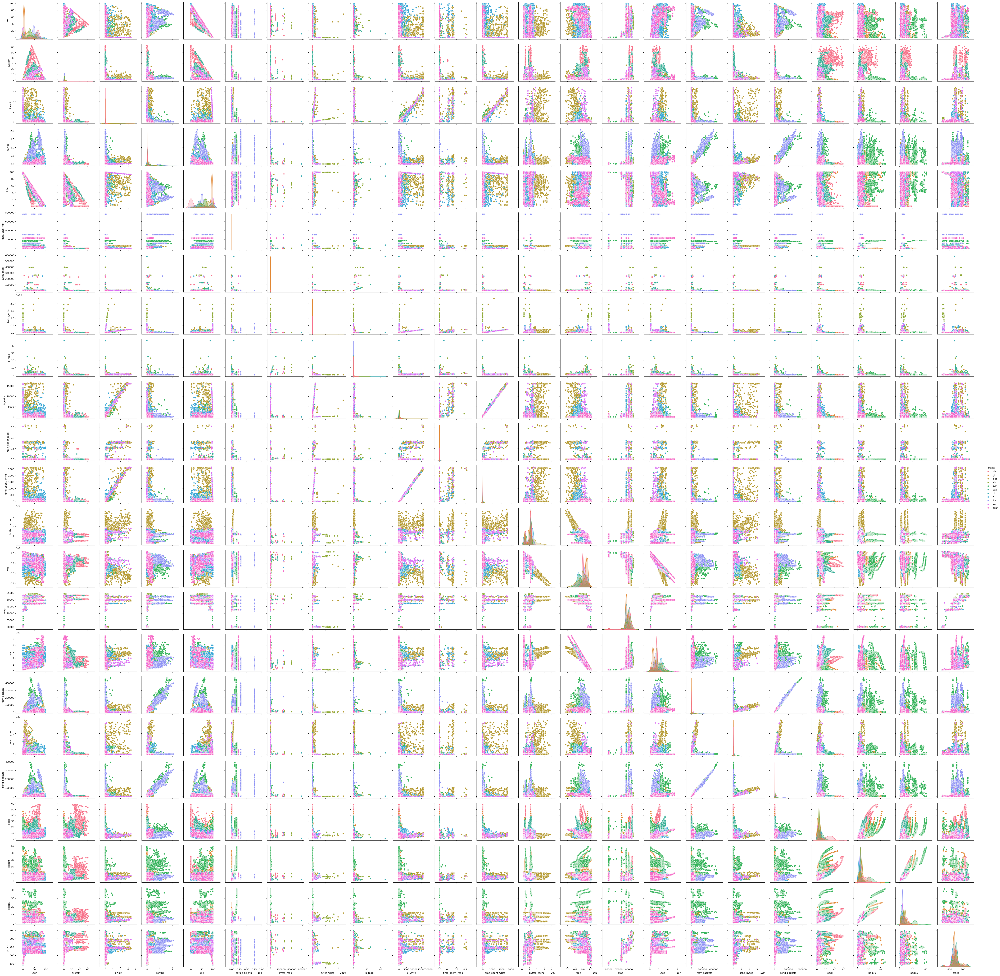

In [360]:
# Gráfico de dispersión que muestra la relación entre las variables numéricas.
sns.pairplot(df, hue='model')

Distribución de variables

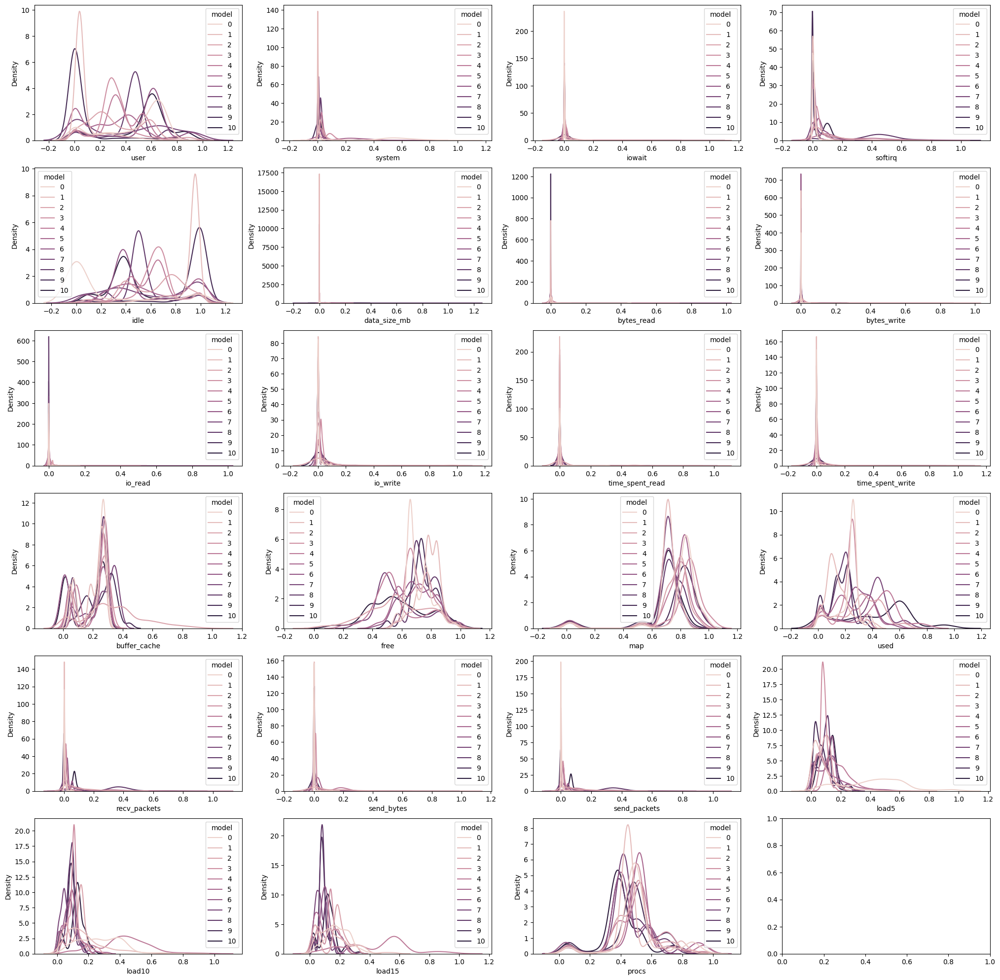

In [375]:
cols = df.columns

fig, ax = plt.subplots(nrows=int(np.floor(len(cols)/4)), ncols = 4, figsize = (25, 25))

i,j = 0,0
for c in cols:
  if c != 'model':
    sns.kdeplot(df, x=c, hue='model', common_norm=False, fill=False, ax=ax[i, j], legend=True)

    j+=1
    if j==4:
        i+=1
        j=0

plt.show();

In [380]:
df = df[['data_size_mb', 'user', 'system', 'softirq', 'used', 'recv_packets', 'load10', 'model']]

# Visualización de un registro de cada categoría después
display(df.drop_duplicates('model', keep='first'))
print(f"{df.shape[0]} rows x {df.shape[1]} columns")

,data_size_mb,user,system,softirq,used,recv_packets,load10,model
0,0.005573,0.001377,0.000798,0.000000,0.006270,0.000104,0.136082,0
4620,0.000110,0.001502,0.000200,0.000000,0.002742,0.000117,0.338144,1
12880,0.069980,0.001002,0.000399,0.006062,0.003446,0.000104,0.163918,2
16660,0.002244,0.001502,0.000399,0.000000,0.002166,0.000125,0.117113,3
17780,0.224993,0.001251,0.000599,0.000000,0.006441,0.000104,0.621856,4
19201,0.000326,0.000375,0.000200,0.000000,0.004224,0.000013,0.011959,5
22183,0.094205,0.000501,0.000200,0.000000,0.001983,0.000028,0.037526,6
23611,0.043984,0.001377,0.000200,0.000000,0.003273,0.000113,0.107423,7
26705,1.000000,0.000501,0.000399,0.000000,0.005217,0.000055,0.071753,8
30646,0.000480,0.001252,0.000798,0.000000,0.004330,0.000108,0.182887,9


13986 rows x 8 columns


# Entrenamiento del modelo con Cross Validation

1. Se separan datos de entrada y de salida
2. Se separan datos de entrenamiento y test
3. Se instancia el modelo
4. Se usa cross validation para extraer datos de validación de los datos de entrenamiento
5. Se entrena en el modelo con los datos de entrenamiento
6. Se predice el target para los datos de validación
7. Se realiza la evaluación del modelo

In [381]:
##########
# PASO 1 #
##########

# Se separan los datos de entrada y salida
X = df.drop(field_name, axis=1)
y = df[field_name]
display(X)

,data_size_mb,user,system,softirq,used,recv_packets,load10
0,0.005573,0.001377,0.000798,0.000000,0.006270,0.000104,0.136082
1,0.005573,0.000877,0.000599,0.000000,0.004358,0.000100,0.138144
2,0.005573,0.001502,0.000599,0.000000,0.005316,0.000147,0.230103
3,0.005573,0.000376,0.000399,0.000000,0.004968,0.000059,0.131959
4,0.005573,0.001126,0.000798,0.000000,0.007406,0.000106,0.133814
...,...,...,...,...,...,...,...
40000,0.005009,0.271872,0.010192,0.024274,0.091550,0.004445,0.015670
40001,0.005009,0.263209,0.012208,0.018231,0.094587,0.004683,0.017526
40002,0.005009,0.188958,0.008602,0.012149,0.095474,0.004252,0.027010
40003,0.005009,0.219517,0.009800,0.006073,0.090667,0.004509,0.014227


In [382]:
##########
# PASO 2 #
##########

# Se separan datos de train y test
Xtrain, Xtest, ytrain, ytest = train_test_split(X, y, test_size=0.33, random_state=1)

# Visualización de registros de cada categoría
train_samples = ytrain.value_counts()
test_samples = ytest.value_counts()
samples = pd.concat([train_samples, train_samples/len(ytrain), test_samples, test_samples/len(ytest)],
                    axis=1,
                    keys=["train", "train(%)", "test", "test(%)"])

# Editamos los índices en caso de ser valores numéricos
if field_name_to_categorical:
  samples.index = field_categories[samples.index]

samples

,train,train(%),test,test(%)
1,1183,0.126254,567,0.122834
5,1042,0.111206,484,0.104853
2,999,0.106617,513,0.111135
0,938,0.100107,504,0.109185
7,937,0.100000,498,0.107886
8,879,0.093810,409,0.088605
4,844,0.090075,402,0.087088
3,765,0.081644,355,0.076906
10,636,0.067876,309,0.066941
9,577,0.061580,291,0.063042


In [386]:
# Tupla con los modelos a comparar
model_names = ('BernoulliNB',
               'ComplementNB',
               'GaussianNB',
               'MultinomialNB',
               'CategoricalNB',
               'SVC')


# definimos el objeto KFold para separar los datos de entrenamiento.
cv = KFold(n_splits = 5, shuffle = True, random_state=1)

# Función para entrenamiento, predicción y evaluación de un modelo.
def use_model(model_name):

  ##########
  # PASO 3 #
  ##########

  # Obtenemos la clase a partir de su nombre
  # Nota: CategoricalNB no está diseñado para datos continuos. Dará error si
  # en los datos de test hay un valor que no está en los datos de entrenamiento.
  # El parámetno min_categories indica el número de valores 'discretos' distintos
  # que existen para evitar que lo defina sólo con los datos de entramiento.
  model_class = globals()[model_name]
  if model_name == 'CategoricalNB':
    model = model_class(min_categories=((X.max()+1)*1.5).astype(int))
  else:
    model = model_class()

  fold_accuracy = []

  ##########
  # PASO 4 #
  ##########

  # División train y validación aleatoria para el número de splits
  for train_fold, validation_fold in cv.split(Xtrain):

    # Extrae la información (iloc), atendiendo a los indices obtenidos por CrossValidation
    f_train_x = Xtrain.iloc[train_fold]
    f_train_y = ytrain.iloc[train_fold]

    ##########
    # PASO 5 #
    ##########

    # Entrenamos el modelo con los datos de entrenamiento
    model.fit(f_train_x, f_train_y)

    ##########
    # PASO 6 #
    ##########

    # Predicicón de la validación
    y_model = model.predict(Xtrain.iloc[validation_fold])

    # Evaluación y cálculo de la precisión para cada iteración
    accuracy = accuracy_score(ytrain.iloc[validation_fold], y_model)
    fold_accuracy.append(accuracy)

  ##########
  # PASO 7 #
  ##########

  # Evaluación y cálculo de la precisión con cross validation
  accuracy = sum(fold_accuracy)/len(fold_accuracy)

  # Predicción de los datos de test con el modelo entrenado
  y_pred = model.predict(Xtest)
  test_accuracy = accuracy_score(y_pred, ytest)

  print(f"Modelo: {model_name}")
  print(f"Precisión del modelo: {accuracy:.2}")
  print(f"Predicción Test: {test_accuracy:.2}")
  print("---------------------")

  #print(f"accuracy: {accuracy}")
  return model, test_accuracy, y_pred

# Llamada a la función de entrenamiento para cada modelo
models = []
for i, model_name in enumerate(model_names):
  model = (list(use_model(model_name)))
  models.append(model)

Modelo: BernoulliNB
Precisión del modelo: 0.15
Predicción Test: 0.15
---------------------
Modelo: ComplementNB
Precisión del modelo: 0.37
Predicción Test: 0.38
---------------------
Modelo: GaussianNB
Precisión del modelo: 0.81
Predicción Test: 0.81
---------------------
Modelo: MultinomialNB
Precisión del modelo: 0.51
Predicción Test: 0.51
---------------------
Modelo: CategoricalNB
Precisión del modelo: 0.18
Predicción Test: 0.17
---------------------
Modelo: SVC
Precisión del modelo: 0.82
Predicción Test: 0.81
---------------------


## Visualización de resultados

1. Transformación de variables categóricas reales a valores enteros
2. Transformación de variables categóricas predichas a valores enteros
3. Visualización de la matriz de confusión

In [387]:
##########
# PASO 1 #
##########

# Transformamos variables categóricas a valores numéricos/enteros para llamar a la función que pinta la matriz de confusión plot_confusion_matrix()
ytest_df= ytest.to_frame()
ytest_df[field_name].replace(field_categories,range(len(field_categories)), inplace=True)

def transform_to_categorical_array(y_model):
  # Transformamos el resultado de la predicción(array) a un dataframe para transformar los valores categóricos en numéricos
  y_model_df= pd.DataFrame(y_model, columns = [field_name])
  y_model_df[field_name].replace(field_categories,range(len(field_categories)), inplace=True)
  # Y volvemos a transformar el dataframe a un array, que es el tipo de dato que espera la función plot_confusion_matrix()
  y_model_array = y_model_df[field_name].to_numpy()
  return y_model_array

In [388]:
# Y finalmente visualizamos la Matriz de Confusión, para lo que se crea la siguiente función, que se llamará más adelante
# y_true     : dataframe -> Los valores de las clases que son ciertos (test)
# y_pred     : ndarray   -> Los valores calculados de las clases después de realizar la predicción
# classes    : ndarray   -> Los nombres de las clases/valores objetivos como array de numpy
def plot_confusion_matrix(y_true, y_pred, classes,
                          normalize=False,
                          title=None,
                          cmap=plt.cm.Blues,
                          titleSup=None,
                          fig=None,
                          ax=None):

    # Compute confusion matrix
    cm = confusion_matrix(y_true, y_pred)
    # Only use the labels that appear in the data
    classes = classes[unique_labels(y_true, y_pred)]
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    if not fig:
      fig, ax = plt.subplots()
    im = ax.imshow(cm, interpolation='nearest', cmap=cmap)
    ax.figure.colorbar(im, ax=ax)
    # We want to show all ticks...
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           # ... and label them with the respective list entries
           xticklabels=classes, yticklabels=classes,
           title=titleSup,
           ylabel='True label',
           xlabel='Predicted label')
    ax.annotate(title, xy=(0.5, 1.1), xytext=(0, 10),
            xycoords='axes fraction', textcoords='offset points',
            ha='center', va='baseline', fontsize=10)

    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
             rotation_mode="anchor")

    # Loop over data dimensions and create text annotations.
    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(j, i, format(cm[i, j], fmt),
                    ha="center", va="center",
                    color="white" if cm[i, j] > thresh else "black")

    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        title = 'Normalized confusion matrix'
    else:
        title = 'Confusion matrix, without normalization'

    fig.tight_layout()
    fig.suptitle(title, fontsize=16, y=1, ha='center')
    return ax

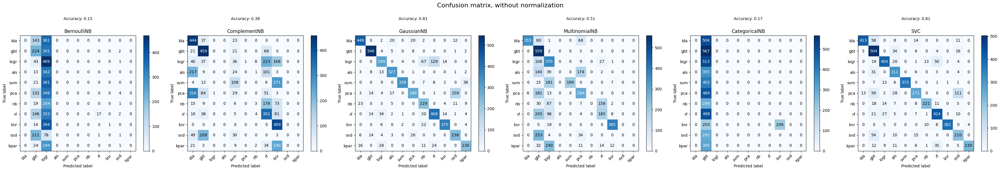

In [389]:
# Creamos el contenedor para representar los resultados
fig, ax = plt.subplots(nrows=1, ncols = len(model_names), figsize = (6*len(model_names),6))

# Representamos la matriz de confusión para cada modelo asignando los parámetros
for idx, model in enumerate(models):

  ##########
  # PASO 2 #
  ##########

  # Transformamos variables categóricas a valores numéricos/enteros
  y_model_array = transform_to_categorical_array(models[idx][2])

  ##########
  # PASO 3 #
  ##########

  # Creamos este array de numpy porque es el parámetro con las clases que espera la función
  classes = np.array(field_categories)
  plot_confusion_matrix(ytest_df[field_name],
                        y_model_array,
                        classes=classes,
                        normalize=False,
                        title=f'Accuracy: {str(round(model[1],2))}',
                        titleSup=model_names[idx],
                        fig=fig,
                        ax=ax[idx%len(model_names)] if len(model_names) > 1 else ax)


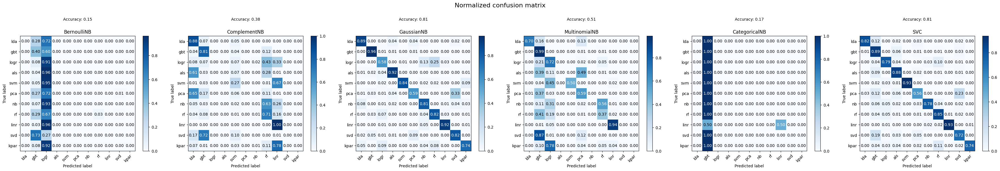

In [390]:
# Creamos el contenedor para representar los resultados normalizados
fig, ax = plt.subplots(nrows=1, ncols = len(model_names), figsize = (6*len(model_names),6))

# Representamos la matriz de confusión normalizada para cada modelo asignando los parámetros
for idx, model in enumerate(models):

  y_model_array = transform_to_categorical_array(models[idx][2])

  # Creamos este array de numpy porque es el parámetro con las clases que espera la función
  classes = np.array(field_categories)
  plot_confusion_matrix(ytest_df[field_name],
                        y_model_array,
                        classes=classes,
                        normalize=True,
                        title=f'Accuracy: {str(round(model[1],2))}',
                        titleSup=model_names[idx],
                        fig=fig,
                        ax=ax[idx%len(model_names)] if len(model_names) > 1 else ax)

# Entrenamiento del modelo sin Cross Validation

1. Se separan datos de entrada y de salida
2. Se separan datos de entrenamiento y test
3. Se instancia el modelo
4. Se entrena en el modelo con los datos de entrenamiento
5. Se predice el target para los datos de test
6. Se realiza la evaluación del modelo

In [391]:
##########
# PASO 1 #
##########

# Se separan los datos de entrada y salida
X = df.drop(field_name, axis=1)
y = df[field_name]
display(X)

,data_size_mb,user,system,softirq,used,recv_packets,load10
0,0.005573,0.001377,0.000798,0.000000,0.006270,0.000104,0.136082
1,0.005573,0.000877,0.000599,0.000000,0.004358,0.000100,0.138144
2,0.005573,0.001502,0.000599,0.000000,0.005316,0.000147,0.230103
3,0.005573,0.000376,0.000399,0.000000,0.004968,0.000059,0.131959
4,0.005573,0.001126,0.000798,0.000000,0.007406,0.000106,0.133814
...,...,...,...,...,...,...,...
40000,0.005009,0.271872,0.010192,0.024274,0.091550,0.004445,0.015670
40001,0.005009,0.263209,0.012208,0.018231,0.094587,0.004683,0.017526
40002,0.005009,0.188958,0.008602,0.012149,0.095474,0.004252,0.027010
40003,0.005009,0.219517,0.009800,0.006073,0.090667,0.004509,0.014227


In [392]:
##########
# PASO 2 #
##########

# Se separan datos de train y test
Xtrain, Xtest, ytrain, ytest = train_test_split(X, y, test_size=0.33, random_state=1)

# Visualización de registros de cada categoría
train_samples = ytrain.value_counts()
test_samples = ytest.value_counts()
samples = pd.concat([train_samples, train_samples/len(ytrain), test_samples, test_samples/len(ytest)],
                    axis=1,
                    keys=["train", "train(%)", "test", "test(%)"])

# Editamos los índices en caso de ser valores numéricos
if field_name_to_categorical:
  samples.index = field_categories[samples.index]

samples

,train,train(%),test,test(%)
1,1183,0.126254,567,0.122834
5,1042,0.111206,484,0.104853
2,999,0.106617,513,0.111135
0,938,0.100107,504,0.109185
7,937,0.100000,498,0.107886
8,879,0.093810,409,0.088605
4,844,0.090075,402,0.087088
3,765,0.081644,355,0.076906
10,636,0.067876,309,0.066941
9,577,0.061580,291,0.063042


In [396]:
# Función para entrenamiento, predicción y evaluación de un modelo.
def use_model(model_name):

  print(f"\n{model_name}\n-------------")
  ##########
  # PASO 3 #
  ##########

  # Obtenemos la clase a partir de su nombre
  # Nota: CategoricalNB no está diseñado para datos continuos. Dará error si
  # en los datos de test hay un valor que no está en los datos de entrenamiento.
  # El parámetno min_categories indica el número de valores 'discretos' distintos
  # que existen para evitar que lo defina sólo con los datos de entramiento.
  model_class = globals()[model_name]
  if model_name == 'CategoricalNB':
    model = model_class(min_categories=((X.max()+1)*1.5).astype(int))
  else:
    model = model_class()

  ##########
  # PASO 4 #
  ##########

  # Entrenamos el modelo con los datos de entrenamiento
  model.fit(Xtrain, ytrain)

  ##########
  # PASO 5 #
  ##########

  # Predicción con los datos de test
  y_model = model.predict(Xtest)

  ##########
  # PASO 6 #
  ##########

  # Evaluación y cálculo de la precisión
  accuracy = accuracy_score(ytest, y_model)
  print(f"accuracy: {accuracy}")
  return model, accuracy, y_model


# Llamada a la función de entrenamiento para cada modelo
models = []
for i, model_name in enumerate(model_names):
  models.append(list(use_model(model_name)))


BernoulliNB
-------------
accuracy: 0.15424610051993068

ComplementNB
-------------
accuracy: 0.3817157712305026

GaussianNB
-------------
accuracy: 0.8056759098786829

MultinomialNB
-------------
accuracy: 0.511265164644714

CategoricalNB
-------------
accuracy: 0.16746100519930676

SVC
-------------
accuracy: 0.8199740034662045


## Visualización de resultados

1. Transformación de variables categóricas reales a valores enteros
2. Transformación de variables categóricas predichas a valores enteros
3. Visualización de la matriz de confusión

In [397]:
##########
# PASO 1 #
##########

# Transformamos variables categóricas a valores numéricos/enteros para llamar a la función que pinta la matriz de confusión plot_confusion_matrix()
ytest_df= ytest.to_frame()
ytest_df[field_name].replace(field_categories,range(len(field_categories)), inplace=True)

def transform_to_categorical_array(y_model):
  # Transformamos el resultado de la predicción(array) a un dataframe para transformar los valores categóricos en numéricos
  y_model_df= pd.DataFrame(y_model, columns = [field_name])
  y_model_df[field_name].replace(field_categories,range(len(field_categories)), inplace=True)
  # Y volvemos a transformar el dataframe a un array, que es el tipo de dato que espera la función plot_confusion_matrix()
  y_model_array = y_model_df[field_name].to_numpy()
  return y_model_array

In [398]:
# Y finalmente visualizamos la Matriz de Confusión, para lo que se crea la siguiente función, que se llamará más adelante
# y_true     : dataframe -> Los valores de las clases que son ciertos (test)
# y_pred     : ndarray   -> Los valores calculados de las clases después de realizar la predicción
# classes    : ndarray   -> Los nombres de las clases/valores objetivos como array de numpy
def plot_confusion_matrix(y_true, y_pred, classes,
                          normalize=False,
                          title=None,
                          cmap=plt.cm.Blues,
                          titleSup=None,
                          fig=None,
                          ax=None):

    # Compute confusion matrix
    cm = confusion_matrix(y_true, y_pred)
    # Only use the labels that appear in the data
    classes = classes[unique_labels(y_true, y_pred)]
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    if not fig:
      fig, ax = plt.subplots()
    im = ax.imshow(cm, interpolation='nearest', cmap=cmap)
    ax.figure.colorbar(im, ax=ax)
    # We want to show all ticks...
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           # ... and label them with the respective list entries
           xticklabels=classes, yticklabels=classes,
           title=titleSup,
           ylabel='True label',
           xlabel='Predicted label')
    ax.annotate(title, xy=(0.5, 1.1), xytext=(0, 10),
            xycoords='axes fraction', textcoords='offset points',
            ha='center', va='baseline', fontsize=10)

    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
             rotation_mode="anchor")

    # Loop over data dimensions and create text annotations.
    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(j, i, format(cm[i, j], fmt),
                    ha="center", va="center",
                    color="white" if cm[i, j] > thresh else "black")

    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        title = 'Normalized confusion matrix'
    else:
        title = 'Confusion matrix, without normalization'

    fig.tight_layout()
    fig.suptitle(title, fontsize=16, y=1, ha='center')
    return ax

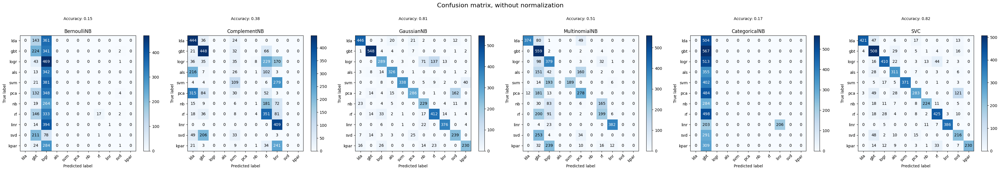

In [401]:
# Creamos el contenedor para representar los resultados
fig, ax = plt.subplots(nrows=1, ncols = len(model_names), figsize = (6*len(model_names),6))

# Representamos la matriz de confusión para cada modelo asignando los parámetros
for idx, model in enumerate(models):

  ##########
  # PASO 2 #
  ##########

  # Transformamos variables categóricas a valores numéricos/enteros
  y_model_array = transform_to_categorical_array(models[idx][2])

  ##########
  # PASO 3 #
  ##########

  # Creamos este array de numpy porque es el parámetro con las clases que espera la función
  classes = np.array(field_categories)
  plot_confusion_matrix(ytest_df[field_name],
                        y_model_array,
                        classes=classes,
                        normalize=False,
                        title=f'Accuracy: {str(round(model[1],2))}',
                        titleSup=model_names[idx],
                        fig=fig,
                        ax=ax[idx%len(model_names)] if len(model_names) > 1 else ax)


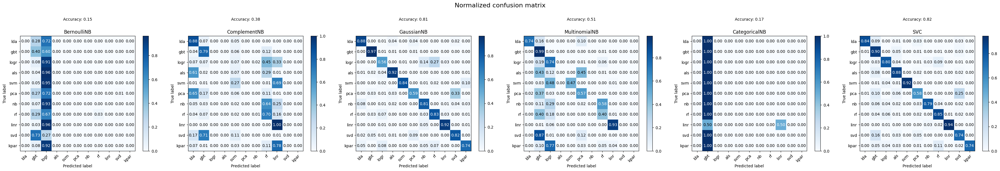

In [402]:
# Creamos el contenedor para representar los resultados normalizados
fig, ax = plt.subplots(nrows=1, ncols = len(model_names), figsize = (6*len(model_names),6))

# Representamos la matriz de confusión normalizada para cada modelo asignando los parámetros
for idx, model in enumerate(models):

  y_model_array = transform_to_categorical_array(models[idx][2])

  # Creamos este array de numpy porque es el parámetro con las clases que espera la función
  classes = np.array(field_categories)
  plot_confusion_matrix(ytest_df[field_name],
                        y_model_array,
                        classes=classes,
                        normalize=True,
                        title=f'Accuracy: {str(round(model[1],2))}',
                        titleSup=model_names[idx],
                        fig=fig,
                        ax=ax[idx%len(model_names)] if len(model_names) > 1 else ax)